In [1]:
from model import *

In [2]:
economy = Economy(seed=1000)

Running: assign_firms
Counter: 1000
Running: initialize_reservation
Counter: 1000
Running: initialize_money
Counter: 1000
Running: initialize_price_wage
Counter: 100


In [3]:
for agent in economy.agents:
    print(agent.money)

6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.300000000000001
6.30000000

In [4]:
# economy.step()

In [5]:
years = 500
days = 21*12*years # 21 * 12 steps = 1 year
print(f"Running model for {days} days.")
for _ in range(days): 
    economy.step()    

Running model for 126000 days.
Today is day 1.
start of month.
Running: update_employment_hist
Counter: 1000
Running: set_wage
Counter: 100
Running: unemployed_search
Counter: 1000
Running: employed_search
Counter: 0
Running: budget
Counter: 1000
Running: reset_monthly_stats
Counter: 100
Running: buy
Counter: 1000
Running: produce
Counter: 96
Today is day 2.
Running: buy
Counter: 1000
Running: produce
Counter: 96
Today is day 3.
Running: buy
Counter: 1000
Running: produce
Counter: 96
Today is day 4.
Running: buy
Counter: 1000
Running: produce
Counter: 96
Today is day 5.
Running: buy
Counter: 1000
Running: produce
Counter: 96
Today is day 6.
Running: buy
Counter: 1000
Running: produce
Counter: 96
Today is day 7.
Running: buy
Counter: 1000
Running: produce
Counter: 96
Today is day 8.
Running: buy
Counter: 1000
Running: produce
Counter: 96
Today is day 9.
Running: buy
Counter: 1000
Running: produce
Counter: 96
Today is day 10.
Running: buy
Counter: 1000
Running: produce
Counter: 96
Today 

In [6]:
data = economy.datacollector.get_agenttype_vars_dataframe(agent_type=Household)

In [7]:
print(data)

                employment
Step   AgentID            
21     1                 1
       2                 1
       3                 1
       4                 1
       5                 1
...                    ...
126000 996               0
       997               0
       998               0
       999               0
       1000              0

[6000000 rows x 1 columns]


In [8]:
type(data)

pandas.core.frame.DataFrame

In [9]:
avg_by_step = data.groupby('Step')['employment'].mean().reset_index()
max_steps = max(avg_by_step["Step"])
years = 50
steps_count = 21*12*years
avg_by_step = avg_by_step[avg_by_step['Step'] > max_steps - steps_count].reset_index()
avg_by_step['year'] = avg_by_step.index/12

In [10]:
avg_by_step

,index,Step,employment,year
0,5400,113421,0.351,0.000000
1,5401,113442,0.352,0.083333
2,5402,113463,0.355,0.166667
3,5403,113484,0.357,0.250000
4,5404,113505,0.358,0.333333
...,...,...,...,...
595,5995,125916,0.491,49.583333
596,5996,125937,0.491,49.666667
597,5997,125958,0.493,49.750000
598,5998,125979,0.495,49.833333


In [11]:
avg_by_step['employment']

0      0.351
1      0.352
2      0.355
3      0.357
4      0.358
       ...  
595    0.491
596    0.491
597    0.493
598    0.495
599    0.497
Name: employment, Length: 600, dtype: float64

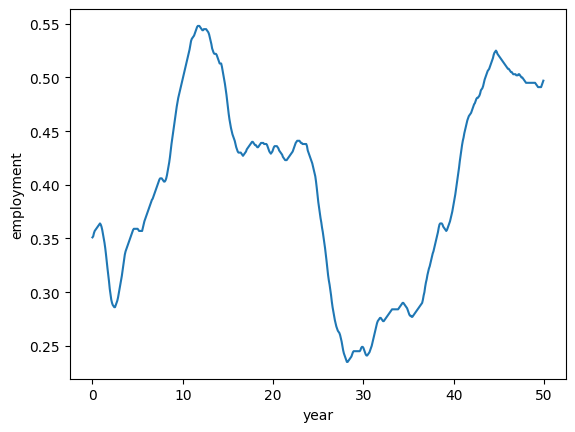

In [12]:
g = sns.lineplot(
    data=avg_by_step,
    x = 'year',
    y = 'employment'
    )

In [13]:
fdata = data = economy.datacollector.get_agenttype_vars_dataframe(agent_type=Firm)

In [14]:
fdata

output         price  employees        demand  vacancies  \
Step   AgentID                                                             
21     1001        504  1.000000e+00          8  7.290000e+01        inf   
       1002        819  1.000000e+00         13  3.870000e+01        inf   
       1003        315  1.000000e+00          5  7.080000e+01        inf   
       1004        567  1.000000e+00          9  5.490000e+01        inf   
       1005        567  1.000000e+00          9  6.630000e+01        inf   
...                ...           ...        ...           ...        ...   
126000 1096          0  2.639917e-18          0  3.685815e-06        0.0   
       1097          0  4.716395e-18          0  4.443131e-06        0.0   
       1098          0  6.168288e-18          0  1.250108e-06        0.0   
       1099          0  5.107512e-18          0  1.153963e-07        0.0   
       1100          0  1.590891e-18          0  4.634349e-05        0.0   

                   inventory  
Step   AgentID                
21     1001     4.311000e+02  
       1002     7.803000e+02  
       1003     2.442000e+02  
       1004     5.121000e+02  
       1005     5.007000e+02  
...                      ...  
126000 1096     8.040600e+04  
       1097     1.279497e+06  
       1098     8.909988e+02  
       1099     2.793000e+03  
       1100     1.322099e+04  

[600000 rows x 6 columns]

In [22]:
fdata_avg = fdata.groupby('Step').sum().reset_index()
fdata_avg

,Step,output,price,employees,demand,vacancies,inventory
0,21,63000,1.000000e+02,1000,6000.000000,inf,5.700000e+04
1,42,63063,1.000000e+02,1001,6296.849088,inf,1.137662e+05
2,63,57015,1.000144e+02,905,12108.429610,inf,1.586727e+05
3,84,50967,1.000305e+02,809,22696.879415,inf,1.869428e+05
4,105,44919,1.000410e+02,713,37829.132973,inf,1.940327e+05
...,...,...,...,...,...,...,...
5995,125916,30933,3.539283e-16,491,10878.001400,0.0,4.465946e+06
5996,125937,30933,3.517748e-16,491,11319.001360,0.0,4.485560e+06
5997,125958,31059,3.491810e-16,493,11760.001386,0.0,4.504859e+06
5998,125979,31185,3.462452e-16,495,12201.001369,0.0,4.523843e+06


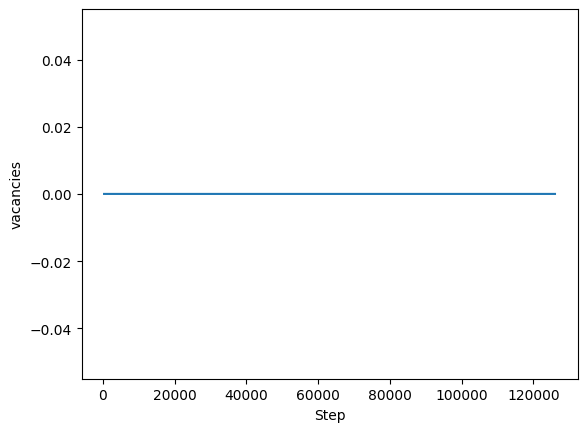

In [23]:
g = sns.lineplot(
    data=fdata_avg,
    x = 'Step',
    y = 'vacancies'
    )